### Model Validation

In this Notebook, we perform some initial validations to perceive the model's consistensy

Including:
- evaluating the cycling potential of bike trips and comparing with car and walking (the cycling trips should have greater cycling potential)
- a slope validation - comparing with the municipal topological data;

In [1]:
# importing data and auxiliar functions

import saopaulo.sp_grid as gr
import bikescience.distributions as dist
import saopaulo.cycling_potential as cp
import saopaulo.choropleth_folium as choro_folium
import saopaulo.choropleth as choro
from bikescience.slope import plot_slope, plot_slopes, split_route
from shapely.geometry import LineString
import ast
from numpy import nan

import folium
import pandas as pd
import geopandas as gpd
from ipywidgets import interact_manual, widgets, fixed
import matplotlib.pyplot as plt
import matplotlib.ticker as tkr
import warnings
import numpy as np
warnings.simplefilter('ignore')

/home/pedro/.local/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
#read data

zone_shp = gpd.read_file('../data/sao-paulo/od/shapes/Zonas_2017_region.shp')
zone_shp.crs = {'init': 'epsg:31983'}  
zone_shp.to_crs(epsg='4326', inplace=True)

# read routes files and join with general trips file
od_trips = pd.read_csv('bases/complete_csv.csv')
# fix FE_VIA with wrong format (because of thousand separator)
od_trips.loc[od_trips['FE_VIA'] >= 10000, 'FE_VIA'] = od_trips.loc[od_trips['FE_VIA'] >= 10000, 'FE_VIA'] / 1000

od_trips.set_index('ID_ORDEM', inplace=True, drop=False)

od_trips.dropna(inplace = True)

the_grid = gr.create(n=9, west_offset=-0.15, east_offset=0.23, north_offset=0.19, south_offset=-0.46)

In [3]:
od_trips = gpd.GeoDataFrame(od_trips, crs={'init': 'epsg:4326'},
                 geometry=[LineString(eval(r)) for r in od_trips['route']])

In [4]:
bike_routes = gpd.read_file('../data/sao-paulo/od/routes/bike_routes_all.shp')
bike_routes.crs = {'init': 'epsg:4326'}
bike_routes['length'] = bike_routes['geometry'].length * 100000
cp_list = []
for i, r in bike_routes.iterrows():
    try:
        pot_d, pot_a, pot_i = cp.cycling_potential_variables(r)
        cp_list.append(['bike', r['ID_ORDEM'], 
                        pot_d, pot_a, pot_i, 
                        (pot_i + pot_a + pot_d) / 3, 
                        r['FE_VIA'], r['MUNI_O']])
    except:
        pass
columns = ['modal', 'trip_id', 'distance_potential', 'age_potential', 
           'inclination_potential', 'final_potential','FE_VIA', 'Muni']
bike_trips = pd.DataFrame(data = cp_list, columns = columns)

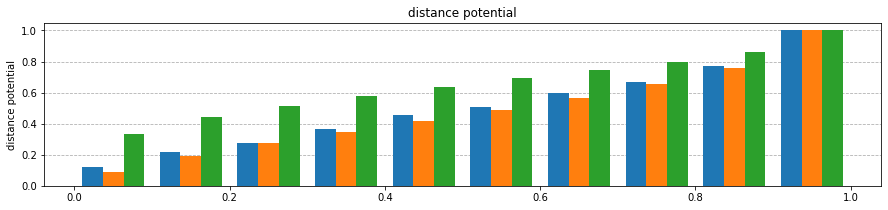

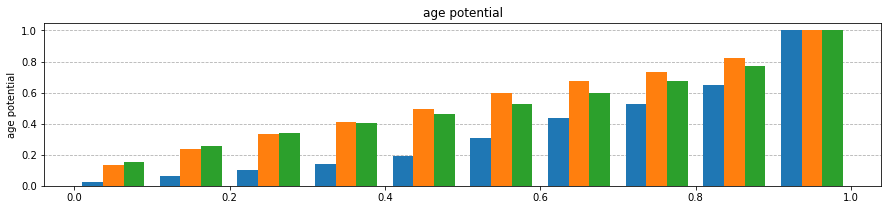

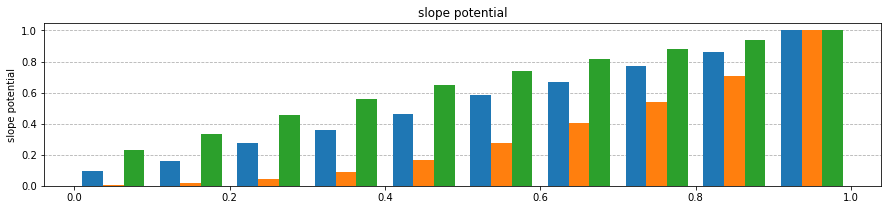

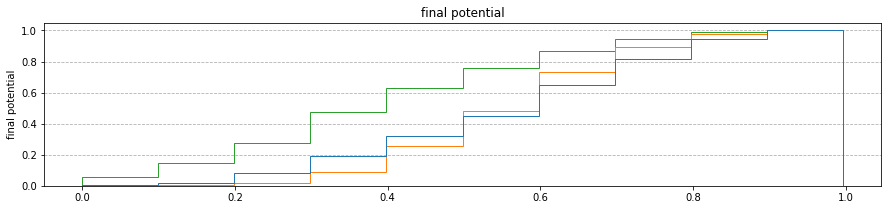

In [5]:
plt.figure(figsize=(15,3))
ax_distance = plt.axes()
ax_distance.set_axisbelow(True)
plt.grid(linestyle='--')
ax_distance.xaxis.grid(False)
plt.hist([bike_trips['distance_potential'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['distance_potential'],
             od_trips.loc[od_trips['modal'] == 'car']['distance_potential']],
            weights = 
            [bike_trips['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'car']['FE_VIA']], 
         density = True, cumulative = 1)
#plt.xticks([1, 2, 3], ['cycling', 'walking', 'car'])
plt.title('distance potential')
plt.ylabel('distance potential')
plt.show()

plt.figure(figsize=(15,3))
ax_distance = plt.axes()
ax_distance.set_axisbelow(True)
plt.grid(linestyle='--')
ax_distance.xaxis.grid(False)
plt.hist([bike_trips['age_potential'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['age_potential'],
             od_trips.loc[od_trips['modal'] == 'car']['age_potential']],
            weights = 
            [bike_trips['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'car']['FE_VIA']], 
         density = True, cumulative = 1)
#plt.xticks([1, 2, 3], ['cycling', 'walking', 'car'])
plt.title('age potential')
plt.ylabel('age potential')
plt.show()

plt.figure(figsize=(15,3))
ax_distance = plt.axes()
ax_distance.set_axisbelow(True)
plt.grid(linestyle='--')
ax_distance.xaxis.grid(False)
plt.hist([bike_trips['inclination_potential'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['inclination_potential'],
             od_trips.loc[od_trips['modal'] == 'car']['inclination_potential']],
            weights = 
            [bike_trips['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'car']['FE_VIA']], 
         density = True, cumulative = 1)
#plt.xticks([1, 2, 3], ['cycling', 'walking', 'car'])
plt.title('slope potential')
plt.ylabel('slope potential')
plt.show()

plt.figure(figsize=(15,3))
ax_distance = plt.axes()
ax_distance.set_axisbelow(True)
plt.grid(linestyle='--')
ax_distance.xaxis.grid(False)
plt.hist(bins = 10,
         x = [bike_trips['final_potential'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['final_potential'],
             od_trips.loc[od_trips['modal'] == 'car']['final_potential']],
         weights = 
            [bike_trips['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'pedestrian']['FE_VIA'],
             od_trips.loc[od_trips['modal'] == 'car']['FE_VIA']], 
         density = True, histtype='step', cumulative = 1,
        label = ['cycling', 'walking', 'car'])
#plt.xticks([1, 2, 3], ['cycling', 'walking', 'car'])
plt.title('final potential')
plt.ylabel('final potential')
plt.show()

In [6]:
def print_boxplot_limits(variable, data_modals, modals_name, step = 25):
    column = variable + '_potential'
    
    for i in range(len(data_modals)):
        modal = data_modals[i]
        print('-------------------------', modals_name[i])
        y, x = (np.histogram(modal[column], 
                             bins = 100, 
                             weights = modal['FE_VIA'], 
                             density = True))
        total = quarter = 0
        for i in range(len(y)):
            perc = round(y[i] * (x[i+1] - x[i]) * 100, 2)
            total += perc
            if total >= quarter - 0.5:
                quarter += step
                print(round(x[i], 3), '-',
                      round(x[i + 1], 3), ':\t', 
                      perc, '%\t\t', round(total), '%')

In [7]:
print_boxplot_limits('final', 
                     [bike_trips.loc[bike_trips['Muni'] == 36], 
                      od_trips.loc[od_trips['modal'] == 'pedestrian'], 
                      od_trips.loc[od_trips['modal'] == 'car']],
                     ['cycling', 'walking', 'car'],
                    5)

------------------------- cycling
0.042 - 0.052 :	 0.05 %		 0 %
0.261 - 0.271 :	 0.15 %		 5 %
0.328 - 0.337 :	 0.18 %		 10 %
0.356 - 0.366 :	 1.33 %		 15 %
0.394 - 0.404 :	 1.69 %		 20 %
0.442 - 0.451 :	 2.26 %		 27 %
0.49 - 0.499 :	 0.75 %		 30 %
0.537 - 0.547 :	 1.21 %		 36 %
0.575 - 0.585 :	 1.71 %		 40 %
0.623 - 0.632 :	 2.06 %		 46 %
0.651 - 0.661 :	 3.85 %		 53 %
0.661 - 0.67 :	 2.17 %		 55 %
0.689 - 0.699 :	 1.88 %		 61 %
0.708 - 0.718 :	 2.26 %		 65 %
0.737 - 0.746 :	 1.94 %		 71 %
0.775 - 0.785 :	 2.16 %		 76 %
0.813 - 0.823 :	 2.74 %		 82 %
0.842 - 0.851 :	 2.24 %		 86 %
0.851 - 0.861 :	 3.8 %		 90 %
0.908 - 0.918 :	 1.69 %		 95 %
0.956 - 0.965 :	 0.64 %		 100 %
------------------------- walking
0.0 - 0.01 :	 0.05 %		 0 %
0.349 - 0.359 :	 0.91 %		 5 %
0.399 - 0.409 :	 1.29 %		 10 %
0.429 - 0.439 :	 1.43 %		 15 %
0.458 - 0.468 :	 1.73 %		 20 %
0.488 - 0.498 :	 2.05 %		 25 %
0.518 - 0.528 :	 2.11 %		 32 %
0.538 - 0.548 :	 2.56 %		 36 %
0.558 - 0.568 :	 2.26 %		 41 %
0.578 - 0.5

In [8]:
# Slope Validation with GeoSampa topography data

declividade = gpd.read_file('../data/sao-paulo/declividade/sirgas_declividade.shp')
declividade.crs = {'init': 'epsg:31983'}  
declividade.to_crs(epsg='4326', inplace=True)
display(declividade)
display(declividade['CLASSE'].unique())

routes_car = pd.read_csv('../data/sao-paulo/rotas-migracao/new_routes_cars.csv')
routes_car.set_index('trip_id', inplace=True, drop=False)
routes_car = gpd.GeoDataFrame(routes_car, crs={'init': 'epsg:4326'}, 
                              geometry=[LineString(ast.literal_eval(r)) for r in routes_car.route])
routes_car['length'] = routes_car['geometry'].length * 100000

,ID,AREA,CLASSE,CODIGO,geometry
0,4564,0.020051,05 a 25%,2,"POLYGON ((-46.66302 -23.42454, -46.66106 -23.4..."
1,5707,36.261402,05 a 25%,2,"POLYGON ((-46.66876 -23.49221, -46.66877 -23.4..."
2,7048,201.025467,0 a 05%,1,"POLYGON ((-46.66889 -23.50214, -46.66693 -23.5..."
3,9774,1.494003,25 a 60%,3,"POLYGON ((-46.38387 -23.58982, -46.38289 -23.5..."
4,10088,0.020059,05 a 25%,2,"POLYGON ((-46.38294 -23.59435, -46.38293 -23.5..."
...,...,...,...,...,...
24632,7211,0.010026,05 a 25%,2,"POLYGON ((-46.38282 -23.48869, -46.38281 -23.4..."
24633,7413,0.010023,0 a 05%,1,"POLYGON ((-46.37014 -23.49422, -46.37112 -23.4..."
24634,7383,0.010031,0 a 05%,1,"POLYGON ((-46.37111 -23.49330, -46.37209 -23.4..."
24635,7883,0.010027,0 a 05%,1,"POLYGON ((-46.36541 -23.50961, -46.36639 -23.5..."


array(['05 a 25%', '0 a 05%', '25 a 60%', '> 60%'], dtype=object)

In [9]:
centro = [8909, 3858, 34660, 19500, 11294]
sul1 = [94705, 8562, 86579, 19346, 89158] 
sul2 = [95217, 117543, 108672, 102561, 96214] 
leste1 = [76232, 76812, 17402, 75953, 91429] 
leste2 = [80204, 75324, 82083, 71464, 67350] 
norte1 = [49994, 56684, 56572, 53065, 51269] 
norte2 = [58631, 61798, 62482, 54576, 60744]
oeste = [42535, 46177, 121940, 30157, 124281]

regions = [centro, sul1, sul2, leste1, leste2, norte1, norte2, oeste]
trips = []
for r in regions:
    for trip_id in r: 
        trips.append(trip_id)
        
aux = routes_car.loc[routes_car['trip_id'].isin(trips)]

In [13]:
fmap = gr.map_around_sp(the_grid=None,zoom=10,plot_grid=False)

colors = [None, 'yellow', 'orange', 'red', 'gray']

folium.GeoJson(declividade,
               style_function = lambda x : {'color': 'gray', 'weight': 1, 'opacity': 0.2, 
                                            'fillOpacity': 0.5, 'color': colors[x['properties']['CODIGO']]},
               name='Declividade', control=False).add_to(fmap)

folium.GeoJson(zone_shp,
               style_function = lambda x : {'color': 'black', 'weight': 1, 'opacity': .8, 
                                            'fillOpacity': 0},
               name='Zonas', control=False).add_to(fmap)

for _, r in aux.iterrows():
    plot_slope(fmap, r['geometry'], 'line')

fmap.save('maps/slope_validation.html')
display(fmap)